<!-- ## Notebook for section 4.4: *Do relative representation similarities remain consistent across different datasets?*
This notebook creates the figures for the section 4.4. It plots the similarity values of all model pairs for three dataset pairs (upper row) and with colored training objectives (lower row). -->
# TODO: fill

In [1]:
from itertools import combinations

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib.lines import Line2D
from scipy.stats import spearmanr, pearsonr

from constants import (
    exclude_models,
    exclude_models_w_mae,
    cat_name_mapping,
    model_config_file,
    fontsizes,
    fontsizes_cols,
    model_cat_mapping,
    BASE_PATH_RESULTS,
    ds_list_sim_file,
    cat_color_mapping,
)
from helper import load_model_configs_and_allowed_models, save_or_show, pp_storing_path, load_all_datasetnames_n_info

#### Global variables

In [12]:
# Get list of all datasets
ds_list, ds_info = load_all_datasetnames_n_info(ds_list_sim_file, verbose=False)

# Get subset of datasets
ds_lists = dict(
    ds_row_1_v2=['imagenet-subset-10k', 'wds_vtab_flowers', 'wds_vtab_pcam'],
    ds_row_2_v2=['imagenet-subset-10k', 'wds_vtab_eurosat', 'wds_vtab_dtd'],
    ds_row_3_v2=['imagenet-subset-30k', 'wds_vtab_flowers', 'wds_vtab_pcam'],
    ds_row_4_v2=['imagenet-subset-30k', 'wds_vtab_eurosat', 'wds_vtab_dtd'],
)
curr_ds_list = ds_lists['ds_row_1_v2']

# Experiment configuration
suffix = ''  # '', '_wo_mae'

# Version
version = 'arxiv'
curr_fontsizes = fontsizes if version == 'arxiv' else {k: v + 1 for k, v in fontsizes_cols.items()}

# Path to all similarities
sim_data_path = BASE_PATH_RESULTS / 'aggregated/model_sims/all_metric_ds_model_pair_similarity.csv'
print(sim_data_path)
assert sim_data_path.exists(), f"Path does not exist: {sim_data_path}. Aggregated similarity data not found, please run aggregate_similarities_across_datasets.ipynb before."

# Path to store plots
SAVE = False
storing_path = pp_storing_path(BASE_PATH_RESULTS / 'plots' / 'q2_eurosat_dtd_plots'/ 'fig_4', SAVE)
storing_path

/home/space/diverse_priors/results_rebuttal/aggregated/model_sims/all_metric_ds_model_pair_similarity.csv


PosixPath('/home/space/diverse_priors/results_rebuttal/plots/q2_eurosat_dtd_plots/fig_4')

#### Load model configurations and similarities

In [3]:
# Load model configurations and allowed models
curr_excl_models = exclude_models_w_mae if 'mae' in suffix else exclude_models

model_configs, allowed_models = load_model_configs_and_allowed_models(
    path=model_config_file,
    exclude_models=curr_excl_models,
    exclude_alignment=True,
)

Nr. models original=64


In [4]:
# Load all similarities
all_similarities = pd.read_csv(sim_data_path)
if 'Unnamed: 0' in all_similarities.columns:
    all_similarities = all_similarities.drop(columns=['Unnamed: 0'])
all_similarities.columns = ['Similarity metric', 'DS', 'Model 1', 'Model 2', 'Similarity value', 'Training objective',
                            'Architecture', 'Training data', 'Model size']
print(all_similarities.shape)
# filter out models that are not in the model_configs
all_similarities = all_similarities[
    all_similarities['Model 1'].isin(allowed_models) & all_similarities['Model 2'].isin(allowed_models)]
print(all_similarities.shape)

(185472, 9)
(185472, 9)


In [5]:
all_similarities['Similarity metric'].unique()

array(['CKA RBF 0.2', 'CKA RBF 0.4', 'CKA linear', 'RSA spearman'],
      dtype=object)

In [6]:
# Convert string to tuple
model_cats = list(model_cat_mapping.values())
for cat in model_cats:
    all_similarities.loc[:, cat] = all_similarities.loc[:, cat].apply(eval)
    all_similarities.loc[:, cat] = all_similarities.loc[:, cat].apply(
        lambda x: tuple(sorted([cat_name_mapping[x[0]], cat_name_mapping[x[1]]])))

In [7]:
## Filter bad datasets
model_similarities = all_similarities[all_similarities['DS'].isin(curr_ds_list)].copy().reset_index(drop=True)

### Get SSL pairs in upper corner 

In [8]:
metric = 'CKA linear'
combs = list(combinations(ds_lists['ds_row_1_v2'], 2))

Looks like you are using a tranform that doesn't support FancyArrowPatch, using ax.annotate instead. The arrows might strike through texts. Increasing shrinkA in arrowprops might help.


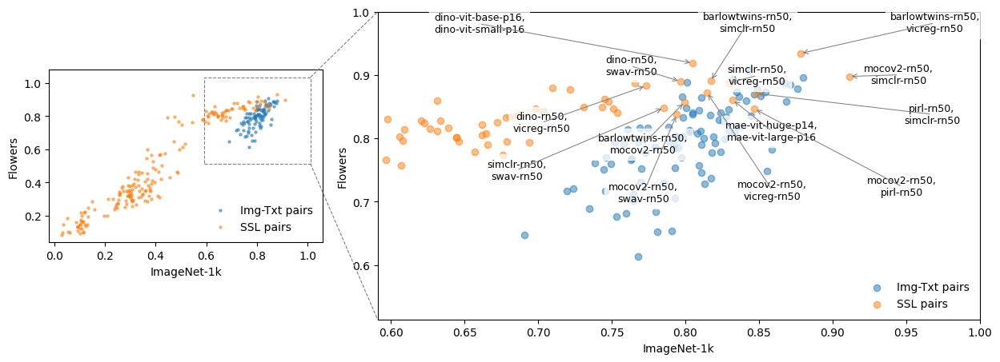

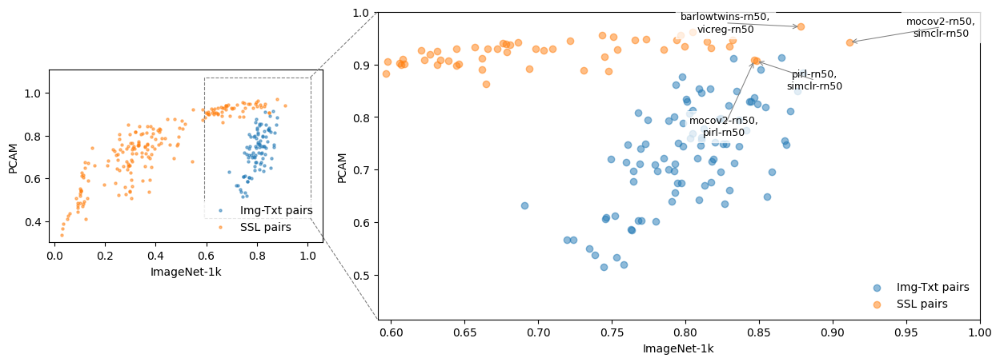

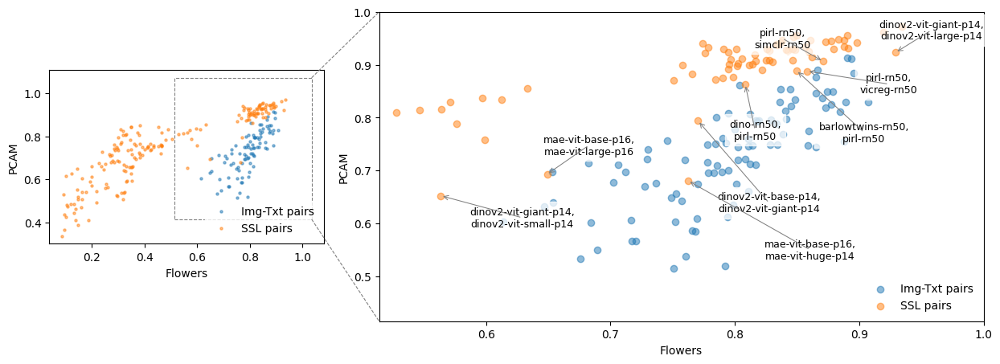

In [9]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from adjustText import adjust_text
from matplotlib.patches import Rectangle
import matplotlib.gridspec as gridspec

from sklearn.neighbors import KNeighborsClassifier

for i, (ds1, ds2) in enumerate(combs):
    ### PREPARE DATA
    ds1_dat = model_similarities[(model_similarities['DS']==ds1) & (model_similarities['Similarity metric']==metric)]
    ds2_dat = model_similarities[(model_similarities['DS']==ds2) & (model_similarities['Similarity metric']==metric)]
    
    ds1_dat_ssl_pairs = ds1_dat[ds1_dat['Training objective']==('SSL', 'SSL')].sort_values(['Model 1', 'Model 2'])
    ds2_dat_ssl_pairs = ds2_dat[ds2_dat['Training objective']==('SSL', 'SSL')].sort_values(['Model 1', 'Model 2'])

    ds1_dat_img_txt_pairs = ds1_dat[ds1_dat['Training objective']==('Img-Txt', 'Img-Txt')].sort_values(['Model 1', 'Model 2'])
    ds2_dat_img_txt_pairs = ds2_dat[ds2_dat['Training objective']==('Img-Txt', 'Img-Txt')].sort_values(['Model 1', 'Model 2'])

    xy_ssl_pairs = np.stack([ds1_dat_ssl_pairs['Similarity value'].values, ds2_dat_ssl_pairs['Similarity value'].values]).T
    xy_img_txt_pairs = np.stack([ds1_dat_img_txt_pairs['Similarity value'].values, ds2_dat_img_txt_pairs['Similarity value'].values]).T
    
    n_ssl = len(xy_ssl_pairs)
    n_it = len(xy_img_txt_pairs)

    ### GET SSL MODEL PAIRS CLOSE TO IMG-TEXT PAIRS
    
    X = np.vstack([xy_ssl_pairs, xy_img_txt_pairs])
    y = np.hstack([np.zeros(n_ssl), np.ones(len(xy_img_txt_pairs))])

    neigh = KNeighborsClassifier(n_neighbors=1)
    neigh.fit(X, y)

    _, kneighbors = neigh.kneighbors(X, n_neighbors=4)

    y_close_1 = y[kneighbors[:, 1]]
    y_close_2 = y[kneighbors[:, 2]]
    y_close_3 = y[kneighbors[:, 3]]

    in_other_cls = (y_close_1 != y) | (y_close_2 != y) | (y_close_3 != y)

    ### CEATE A PLOT THAT HAS THE FULL SCATTER AND THE ZOOMEDIN VERSION THAT VISUALIZED THE SSL PAIRS CLOSE TO  
    fig = plt.figure(figsize=(15, 5))
    gs = gridspec.GridSpec(1, 3)  # Create a 5-column grid with spacers
    
    # Left subplot (full scatterplot) - now only takes up 1/5 of the width
    ax1 = plt.subplot(gs[0])
    ax1.scatter(X[n_ssl:,0], X[n_ssl:,1], color=cat_color_mapping['Img-Txt'], label='Img-Txt pairs', alpha=0.5, s=5)
    ax1.scatter(X[0:n_ssl,0], X[0:n_ssl,1], color=cat_color_mapping['SSL'], label='SSL pairs', alpha=0.5, s=5)
    ax1.set_xlabel(ds_info.loc[ds1, 'name'])
    ax1.set_ylabel(ds_info.loc[ds2, 'name'])
    ax1.legend(loc='lower right', edgecolor='white')
    
    # Add rectangle to indicate zoomed region
    vmin_x = max(xy_ssl_pairs[:,0].min(), xy_img_txt_pairs[:,0].min()) - 0.1
    vmin_y = max(xy_ssl_pairs[:,1].min(), xy_img_txt_pairs[:,1].min()) - 0.1
    rect_coords = (vmin_x, vmin_y), (X[:,0].max()-vmin_x+0.1), (X[:,1].max()-vmin_y+0.1)
    avoid_box = Rectangle(rect_coords[0], rect_coords[1], rect_coords[2], 
                     fill=False, 
                     edgecolor='gray', 
                     linestyle='--', 
                     linewidth=0.8)
    ax1.add_patch(avoid_box)
    
    # Right subplot (zoomed in with annotations) - takes up 2/3 of the width
    ax2 = plt.subplot(gs[1:])
    ax2.scatter(X[n_ssl:,0], X[n_ssl:,1], color=cat_color_mapping['Img-Txt'], label='Img-Txt pairs', alpha=0.5)
    ax2.scatter(X[0:n_ssl,0], X[0:n_ssl,1], color=cat_color_mapping['SSL'], label='SSL pairs', alpha=0.5)
    
    # SSL samples to display
    samples_to_display = X[0:n_ssl][in_other_cls[0:n_ssl], :]
    model_names = ds1_dat_ssl_pairs.loc[in_other_cls[0:n_ssl],:][['Model 1', 'Model 2']]
        
    texts = []
    for i, (x, y) in enumerate(samples_to_display):
        annotation_text = f"{model_names['Model 1'].iloc[i]},\n{model_names['Model 2'].iloc[i]}"
        texts.append(ax2.text(x, y, annotation_text, fontsize=9, bbox=dict(facecolor='white', edgecolor='white', alpha=0.75)))
    
    ax2.set_xlim([vmin_x, 1])
    ax2.set_ylim([vmin_y, 1])
    adjust_text(texts, 
        force_text=(1.5, 1.5),  
        force_points=(2.2, 3.5),
        arrowprops=dict(
            arrowstyle='->', 
            color='grey',
            lw=0.75,
        ),
        expand=(1.7, 2),
        min_arrow_len=3,
        pull_threshold=0.01,
        autoalign='xy',
        add_objects=None,  
        text_from_points=(10, 10),
        avoid_points=True,
        avoid_self=True,
        ax=ax2
    )
    ax2.set_xlabel(ds_info.loc[ds1, 'name'])
    ax2.set_ylabel(ds_info.loc[ds2, 'name'])
    ax2.legend(loc='lower right', edgecolor='white')
    
    # Adjust the height of the left subplot to be half the height of the right subplot
    box1 = ax1.get_position()
    box1.y0 = box1.y0 + box1.height/4
    box1.y1 = box1.y0 + box1.height*0.75
    ax1.set_position(box1)

    # ADD LINES CONNECTING THE TWO PLOTS
    rect_upper_right = [rect_coords[0][0]+rect_coords[1], rect_coords[0][1]+rect_coords[2]]
    rect_lower_right = [rect_coords[0][0]+rect_coords[1], rect_coords[0][1]]
    
    # Transform rectangle corners to figure coordinates
    fig_coords_rect_upper_right = fig.transFigure.inverted().transform(
        ax1.transData.transform(rect_upper_right)
    )
    fig_coords_rect_lower_right = fig.transFigure.inverted().transform(
        ax1.transData.transform(rect_lower_right)
    )
    
    # Right plot corners in figure coordinates
    fig_coords_right_upper_left = fig.transFigure.inverted().transform(
        ax2.transData.transform([ax2.get_xlim()[0], ax2.get_ylim()[1]])
    )
    fig_coords_right_lower_left = fig.transFigure.inverted().transform(
        ax2.transData.transform([ax2.get_xlim()[0], ax2.get_ylim()[0]])
    )
    
    # Create lines in figure coordinates
    upper_connection_line = plt.Line2D(
        [fig_coords_rect_upper_right[0], fig_coords_right_upper_left[0]],
        [fig_coords_rect_upper_right[1], fig_coords_right_upper_left[1]],
        transform=fig.transFigure, color='gray', linestyle='--', linewidth=0.8
    )
    
    lower_connection_line = plt.Line2D(
        [fig_coords_rect_lower_right[0], fig_coords_right_lower_left[0]],
        [fig_coords_rect_lower_right[1], fig_coords_right_lower_left[1]],
        transform=fig.transFigure, color='gray', linestyle='--', linewidth=0.8
    )
    
    fig.lines.append(upper_connection_line)
    fig.lines.append(lower_connection_line)

    if SAVE:
        fn = storing_path / ".." / ".." / "q1_ssl_pairs" / f"ssl_img_txt_pairs_{ds1}_{ds2}_full__with_zoom.pdf"
        plt.savefig(fn)
        plt.close(fig)
        print(f"Stored figure at\n{fn=}")
    else:
        plt.show()


    ### CREATE INTERACTIVE HTML PLOT

    fig = go.Figure()
    
    # Add scatter plots
    fig.add_trace(
        go.Scatter(
            x=ds1_dat_img_txt_pairs['Similarity value'].values,
            y=ds2_dat_img_txt_pairs['Similarity value'].values,
            mode='markers',
            marker=dict(color=cat_color_mapping['Img-Txt'], opacity=0.6),
            name='Img-Txt pairs',
            customdata=list(zip(
                ds1_dat_img_txt_pairs['Model 1'].values,  
                ds1_dat_img_txt_pairs['Model 2'].values   
            )),
            hovertemplate='%{customdata[0]} - %{customdata[1]}'
        )
    )
    
    fig.add_trace(
        go.Scatter(
            x=ds1_dat_ssl_pairs['Similarity value'].values,
            y=ds2_dat_ssl_pairs['Similarity value'].values,
            mode='markers',
            marker=dict(color=cat_color_mapping['SSL'], opacity=0.6),
            name='SSL pairs',
            customdata=list(zip(
                ds1_dat_ssl_pairs['Model 1'].values,  
                ds1_dat_ssl_pairs['Model 2'].values   
            )),
            hovertemplate='%{customdata[0]} - %{customdata[1]}'
        )
    )
    
    # Update layout
    fig.update_layout(
        template='ggplot2',
        xaxis_title=ds_info.loc[ds1, 'name'],
        yaxis_title=ds_info.loc[ds2, 'name'],
        legend=dict(
            yanchor="top",
            y=0.99,
            xanchor="left",
            x=0.01
        )
    )
    
    if SAVE:
        fn = storing_path / ".." / ".." / "q1_ssl_pairs" / f"ssl_img_txt_pairs_{ds1}_{ds2}.html"
        fig.write_html(fn)
        print(f"Stored figure at {fn=}")
    else:
        fig.show()

### Plot the similarity values of all model pairs for three dataset pairs (upper row) and with colored training objectives (lower row)

In [10]:
def get_ds_subsets(ds1, ds2, df, cat_col):
    def process_ds(ds):
        ds_data = df[df['DS'] == ds].copy().sort_values(['Model 1', 'Model 2']).reset_index(drop=True)
        ds_data.loc[:, cat_col] = ds_data.loc[:, cat_col].astype(str)
        return ds_data

    return process_ds(ds1), process_ds(ds2)


def plot_reg(ax, x, y, color_line, color_scatter, marker='o'):
    sns.regplot(
        x=x, y=y,
        # color=color,
        line_kws=dict(alpha=1, ls='--', lw=3, color=color_line),
        scatter_kws=dict(alpha=0.8, s=7, color=color_scatter),
        ci=None, ax=ax,
        marker=marker
    )
    # ax.set(xlim=(-0.01, 1.01), ylim=(-0.01, 1.01))
    ax.tick_params('both', labelsize=curr_fontsizes['ticks'])


def set_ylabel(ax, j, ds2, name, color):
    if j == 0 and version == 'arxiv':
        ax.text(-0.2, 0.5, name, fontsize=curr_fontsizes['title'],
                transform=ax.transAxes, va='center', ha='right', rotation=90, color=color)
    ax.set_ylabel(get_ds_name(ds2), fontsize=curr_fontsizes['title'])


def get_ds_name(ds):
    curr_ds_info = ds_info.loc[ds]
    # return f"{curr_ds_info['name']} ({curr_ds_info['domain']})"
    return f"{curr_ds_info['name']}"

def compute_r(x, y, corr_type):
    corr_funcs = {'spearmanr': spearmanr, 'pearsonr': pearsonr}
    if corr_type not in corr_funcs:
        raise ValueError("Unknown correlation computation type")
    return corr_funcs[corr_type](x, y)[0]


def plot_all_pairs(ax, ds1_data, ds2_data, color_all, corr_type, frameon, box_anchor):
    plot_reg(ax, ds1_data['Similarity value'], ds2_data['Similarity value'], 'dimgray', color_all)
    r_val_combi = compute_r(ds1_data['Similarity value'], ds2_data['Similarity value'], corr_type)
    ax.legend(handles=[Line2D([0], [0], color=color_all, marker='o', linestyle='None', markersize=7, alpha=1)],
              labels=[f"r coeff.: {r_val_combi:.2f}"],
              fontsize=curr_fontsizes['label'],
              framealpha=0.5,
              frameon=frameon, title='', loc='lower right',
              markerfirst=False,
              handletextpad=0.01,
              borderpad=0, bbox_to_anchor=box_anchor,
              edgecolor='white')
    ax.set_xlabel("")


def plot_within_category(ax, ds1_data, ds2_data, cat_col, color_all, cat_colors, corr_type, frameon, box_anchor):
    marker_list = ['o', 's', '^']

    within_cat = ds1_data[cat_col].apply(eval).apply(lambda x: x[0] == x[1])
    ax.scatter(x=ds1_data.loc[~within_cat, 'Similarity value'], y=ds2_data.loc[~within_cat, 'Similarity value'],
               c=color_all, alpha=0.4, s=5)

    ds1_data, ds2_data = ds1_data.loc[within_cat, :], ds2_data.loc[within_cat, :]

    handles, labels = [], []
    for i, cat_pair in enumerate(ds1_data[cat_col].unique()):
        ds1_sub = ds1_data[ds1_data[cat_col] == cat_pair]
        ds2_sub = ds2_data[ds2_data[cat_col] == cat_pair]
        curr_color = cat_colors[eval(cat_pair)[0]]

        plot_reg(ax, ds1_sub['Similarity value'], ds2_sub['Similarity value'], curr_color, curr_color, marker_list[i])
        r_val_combi = compute_r(ds1_sub['Similarity value'], ds2_sub['Similarity value'], corr_type)
        handles.append(
            Line2D([0], [0], color=curr_color, marker=marker_list[i], linestyle='None', markersize=7, alpha=1))
        labels.append(f"r {eval(cat_pair)[0]}: {r_val_combi:.2f}")

    ax.legend(handles=handles, labels=labels, fontsize=curr_fontsizes['label'], framealpha=0.75,
              frameon=frameon, title='', loc='lower right', edgecolor='white', handletextpad=0.01, alignment='right',
              markerfirst=False, reverse=True, borderpad=0, bbox_to_anchor=box_anchor)


def main_plot(curr_ds_list, tmp, cat_col, color_all, cat_colors, corr_type, frameon, box_anchor):
    combs = list(combinations(curr_ds_list, 2))
    n, m = 2, len(combs)
    fig, axs = plt.subplots(nrows=n, ncols=m, figsize=(5 * m, 4 * n), sharex=True, sharey=True)

    ticks = np.linspace(0, 1, 3)
    tick_labels = [f'{x:.1f}' for x in ticks]

    for j, (ds1, ds2) in enumerate(combs):
        ds1_data, ds2_data = get_ds_subsets(ds1, ds2, tmp, cat_col)

        # Upper row: all pairs
        plot_all_pairs(axs[0, j], ds1_data, ds2_data, color_all, corr_type, frameon, box_anchor)
        set_ylabel(axs[0, j], j, ds2, "All model pairs", 'black')

        # Lower row: within category
        plot_within_category(axs[1, j], ds1_data, ds2_data, cat_col, color_all, cat_colors, corr_type, frameon,
                             box_anchor)
        axs[1, j].set_xlabel(get_ds_name(ds1), fontsize=curr_fontsizes['title'])
        set_ylabel(axs[1, j], j, ds2, "Within training objective", 'black')

        for ax in [axs[0, j], axs[1, j]]:
            ax.set_xticks(ticks)
            ax.set_yticks(ticks)
            ax.set_xticklabels(tick_labels, fontsize=curr_fontsizes['ticks'])
            ax.set_yticklabels(tick_labels, fontsize=curr_fontsizes['ticks'])

    fig.subplots_adjust(hspace=0.1, wspace=0.15)
    return fig

CKA RBF 0.4 pearsonr


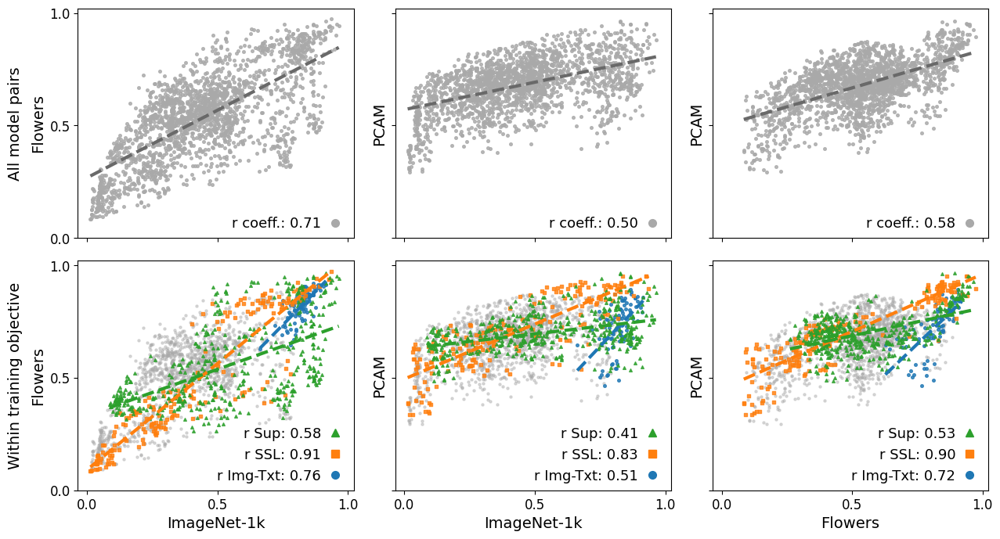

CKA RBF 0.4 spearmanr


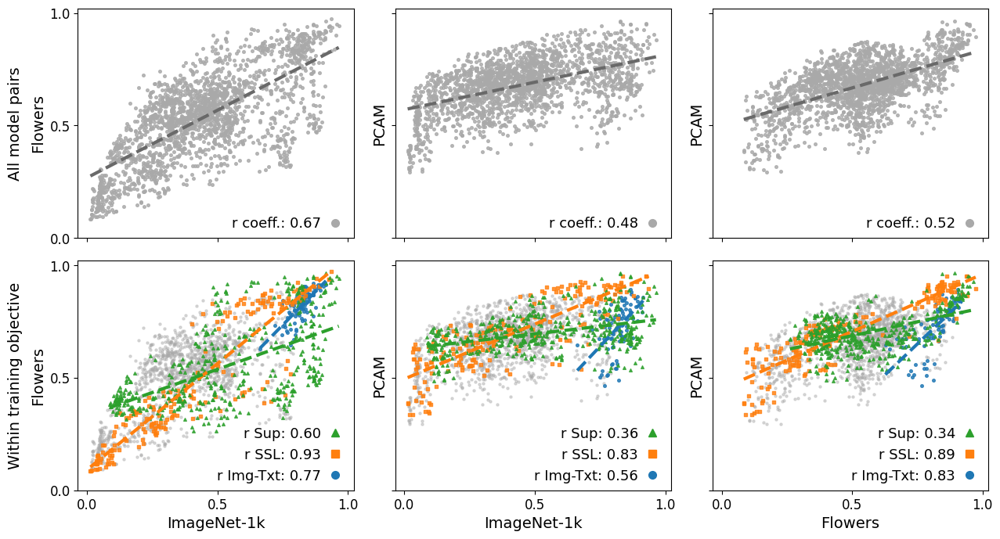

CKA linear pearsonr


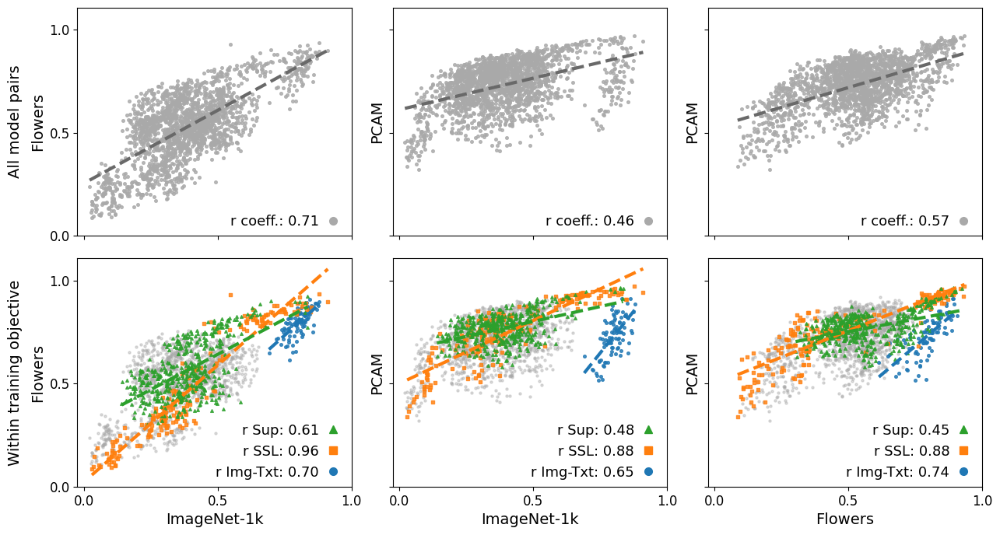

CKA linear spearmanr


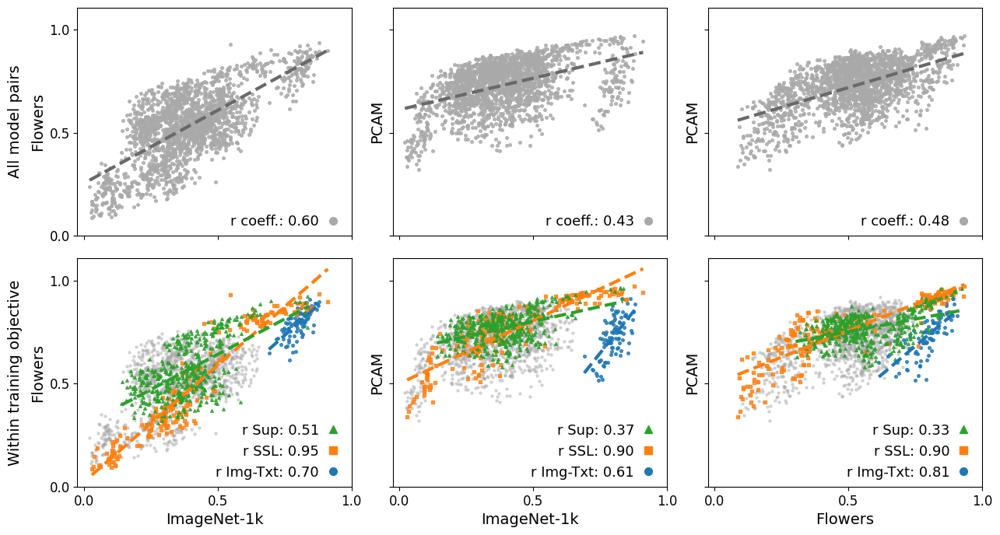

RSA spearman pearsonr


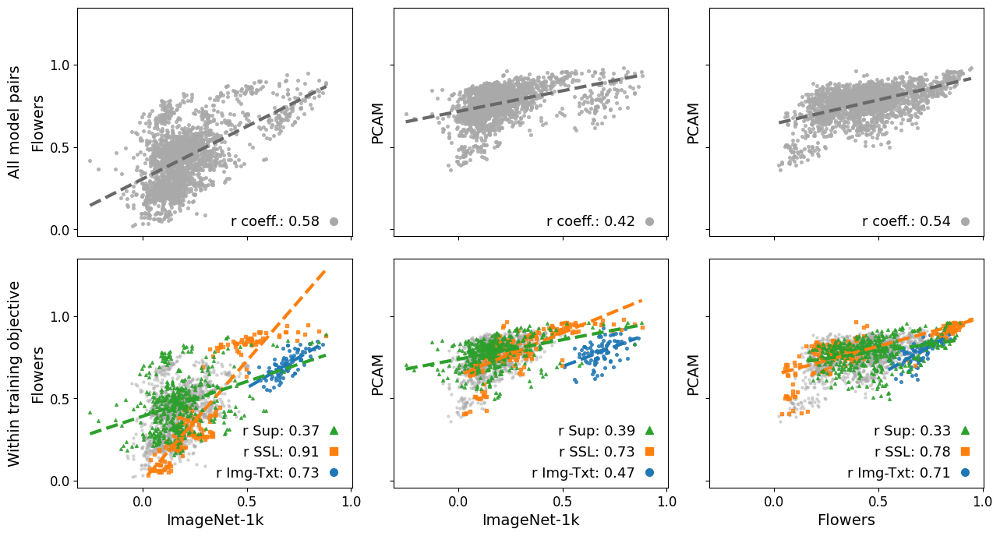

RSA spearman spearmanr


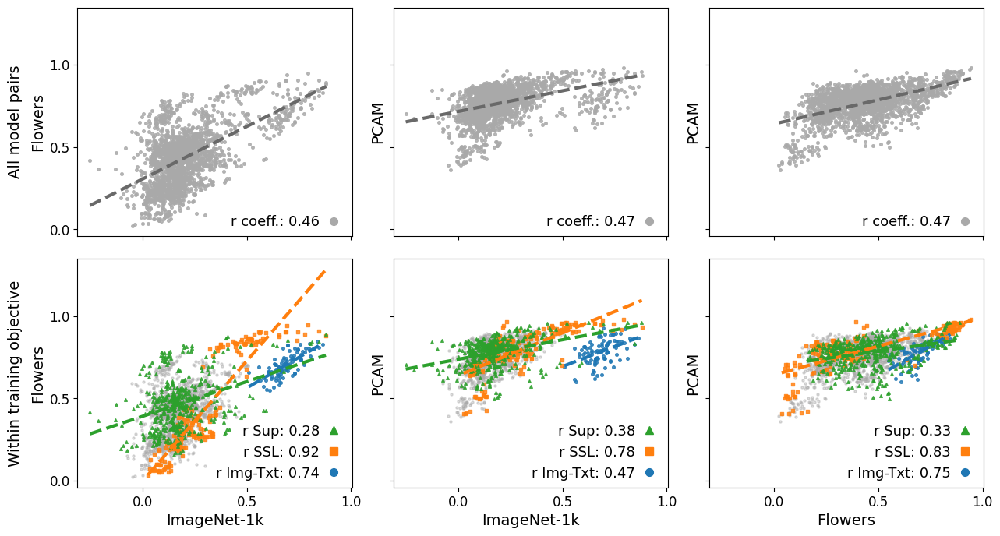

In [11]:
import numpy as np

cat_col = 'Training objective'
color_all = 'darkgrey'
frameon = False
box_anchor = (1.01, 0) if version == 'arxiv' else (1.05, 0)

for sim_metric, data in model_similarities.groupby('Similarity metric'):
    if sorted(data['DS'].unique()) != sorted(curr_ds_list):
        continue
    for corr_type in ['pearsonr', 'spearmanr']:
        print(sim_metric, corr_type)
        cat_ois = sorted(list(set([element for tup in data[cat_col].unique() for element in tup])))
        cat_colors = {cat_oi: color for cat_oi, color in zip(cat_ois, sns.color_palette('tab10', len(cat_ois)))}
        fig = main_plot(curr_ds_list, data, cat_col, color_all, cat_colors, corr_type=corr_type, frameon=frameon,
                        box_anchor=box_anchor)

        curr_sim = sim_metric.lower().replace(' ', '_')
        curr_cat_col = cat_col.lower().replace(' ', '_')
        dss = "-".join(curr_ds_list).lower().replace(' ', '_')
        save_or_show(fig, storing_path / f'{curr_cat_col}_{dss}_{corr_type}_{curr_sim}{suffix}.pdf', SAVE)